# Figure S4 - Read Until Efficiency

## Further Analysis of Selective Sequencing



In [14]:
library(ggplot2)
library("gridExtra")
library("plyr")
library("rgl")

# Simulations of Sequencing at 30 b/s enrichmient over the lambda genome.

Using the ws_event_sampler.exe program in simulation mode, we investigated the consequences of delay time on read until efficiency.



Using the ws_event_sampler utility in simulator mode, we simulate the experiment in figure 2 A - two 5kb regions of the genome. Note that for this simulation, reads are ejected every 15 seconds.

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type
1,31,J02459_R,5518,4915,TGATCGCCTTGCACTC,2,2115,387,Unblock,Template
2,33,J02459_R,42782,4988,GCAAATCGTTAACGGC,2,2115,387,Unblock,Template
3,35,J02459_F,19191,5061,GGGGTTCGCCGCGTCG,2,2115,387,Unblock,Template
4,37,J02459_F,27431,4981,ACTGCTATCTTCTTAC,2,2115,387,Unblock,Template
5,103,J02459_R,3369,4958,TACTGATAGAACAAAT,2,2115,387,Unblock,Template
6,105,J02459_R,2388,4915,GCCGCGTTCGCCAGCT,2,2115,387,Unblock,Template


,Ref,Position,EVEN,ODD,ALL
1,simref,0,6,0,6
2,simref,1,6,0,6
3,simref,2,6,0,6
4,simref,3,6,1,7
5,simref,4,6,1,7
6,simref,5,6,1,7


[1] 59510061

[1] 29827907

[1] 29682154

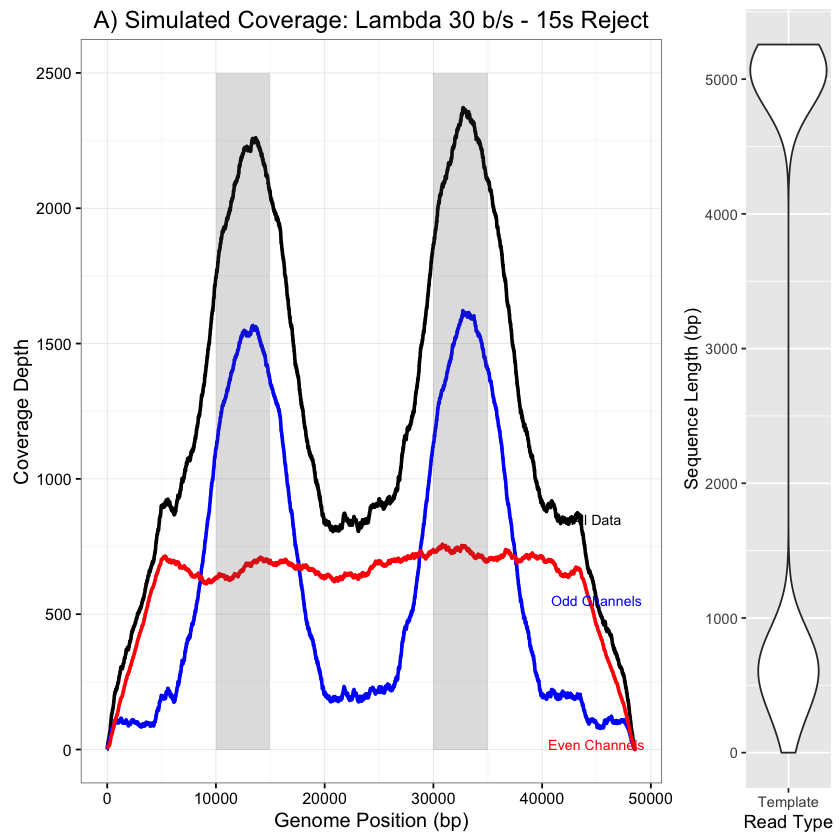

In [42]:
rawdata = read.csv("data/simulations/lambda_shortreads_15s_250m_5kb.log", header = TRUE, sep=",")


rawdata$type<-"Template"
head (rawdata)
#ggplot(data=rawdata,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")



EVEN2_SIM_1D_ROI = read.csv("data/simulations/512_2_5kb_FR_ru2_15s_250m_EVEN.txt", header = FALSE,sep="\t")
ODD2_SIM_1D_ROI = read.csv("data/simulations/512_2_5kb_FR_ru2_15s_250m_ODD.txt", header = FALSE,sep="\t")
ALL2_SIM_1D_ROI = read.csv("data/simulations/512_2_5kb_FR_ru2_15s_250m_ALL.txt", header = FALSE,sep="\t")


SIM_ROI2<-cbind(EVEN2_SIM_1D_ROI,ODD2_SIM_1D_ROI$V3,ALL2_SIM_1D_ROI$V3)
colnames(SIM_ROI2) <- c("Ref", "Position","EVEN","ODD","ALL")
head(SIM_ROI2)

#ggplot(data=SIM_ROI2,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "D) Simulated Coverage: Lambda 30 b/s")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)



sum(SIM_ROI2$ALL)
sum(SIM_ROI2$EVEN)
sum(SIM_ROI2$ODD)



Fig2Bi<-ggplot(data=SIM_ROI2,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "A) Simulated Coverage: Lambda 30 b/s - 15s Reject")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)
Fig2Bii<-ggplot(data=rawdata,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Bi,Fig2Bii,       ncol=2, nrow=1, widths=c(16, 4))



In [50]:

rawdata$OddEven = "Odd Channels: Read Until"
rawdata$OddEven[rawdata$channel_name %% 2 == 0]<-"Even Channels: No Read Until"
rawdata$readuntil[rawdata$read_reason == "Unblock"]<-"Rejected"
rawdata$readuntil[rawdata$read_reason == "Natural"]<-"Sequenced"
rawdata$orientation[rawdata$seq_name == "J02459_R"]<-"Reverse"
rawdata$orientation[rawdata$seq_name == "J02459_F"]<-"Forward"
rawdata$start[rawdata$seq_name == "J02459_F"]<-rawdata$seq_index[rawdata$seq_name=="J02459_F"]
rawdata$start[rawdata$seq_name == "J02459_R"]<-48600-rawdata$seq_index[rawdata$seq_name=="J02459_R"]
head (rawdata)

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type,OddEven,readuntil,orientation,start
1,31,J02459_R,5518,4915,TGATCGCCTTGCACTC,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,43082
2,33,J02459_R,42782,4988,GCAAATCGTTAACGGC,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,5818
3,35,J02459_F,19191,5061,GGGGTTCGCCGCGTCG,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,19191
4,37,J02459_F,27431,4981,ACTGCTATCTTCTTAC,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,27431
5,103,J02459_R,3369,4958,TACTGATAGAACAAAT,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,45231
6,105,J02459_R,2388,4915,GCCGCGTTCGCCAGCT,2,2115,387,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,46212


By plotting the read_event_count against the seq_index (corresponding to the sequence start) we can see the read length distribution. Reads are coloured according to the read_reason where Unblock is a rejected read, Natural is a read allowed to sequence to completion and Stopped are those reads that were lost at the point ws_event_sampler was shut down.

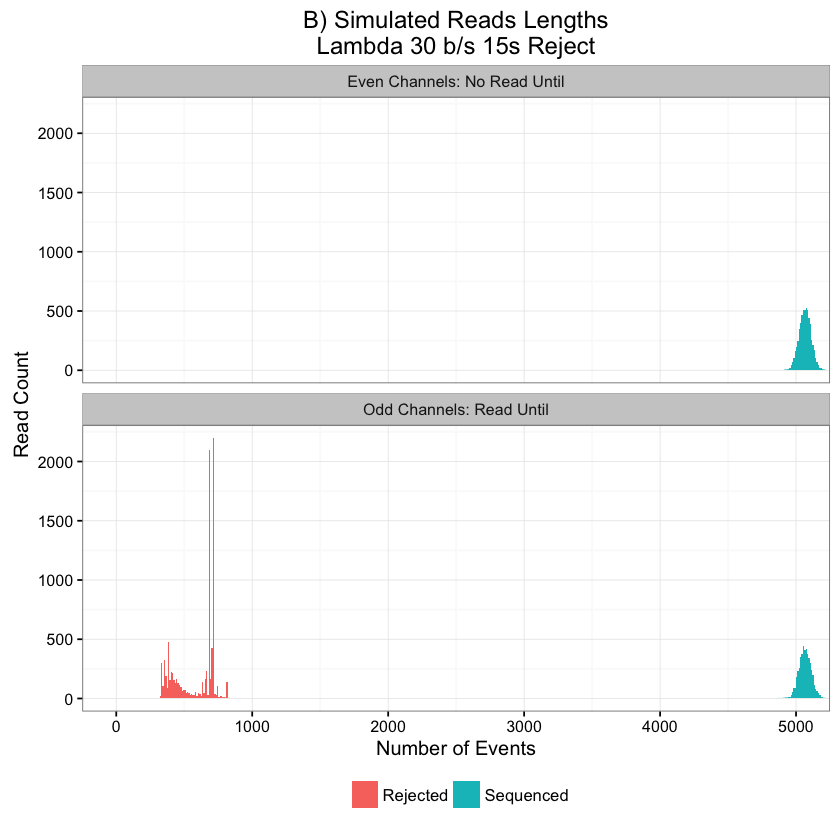

In [36]:
FigS4C=ggplot(data=subset(rawdata,read_reason!="Stopped"),aes(x=read_event_count,fill=readuntil)) + geom_histogram(binwidth=10,position="identity",alpha = 1)+ facet_wrap(~OddEven,ncol=1) + coord_cartesian(xlim = c(0,5000))  + theme_bw()+ theme(legend.title=element_text(size=10),legend.position="bottom",legend.key = element_blank(),legend.text = element_text(size = 10, colour = "black", angle = 0)) + scale_fill_discrete(guide = guide_legend(title = NULL))+ labs(y="Read Count",x="Number of Events",title = "B) Simulated Reads Lengths\nLambda 30 b/s 15s Reject")
FigS4C

By plotting read length against the sequence start site in the genome, it is possible to determine the efficacy of the squiggle matching. Recall that the gReadUntil.py script applies a shift on accepted read positions of 3 kb in this case. Also note that the read until simulator only simulates forward strand reads and so this offset is only visible in the 7-10 kb window.

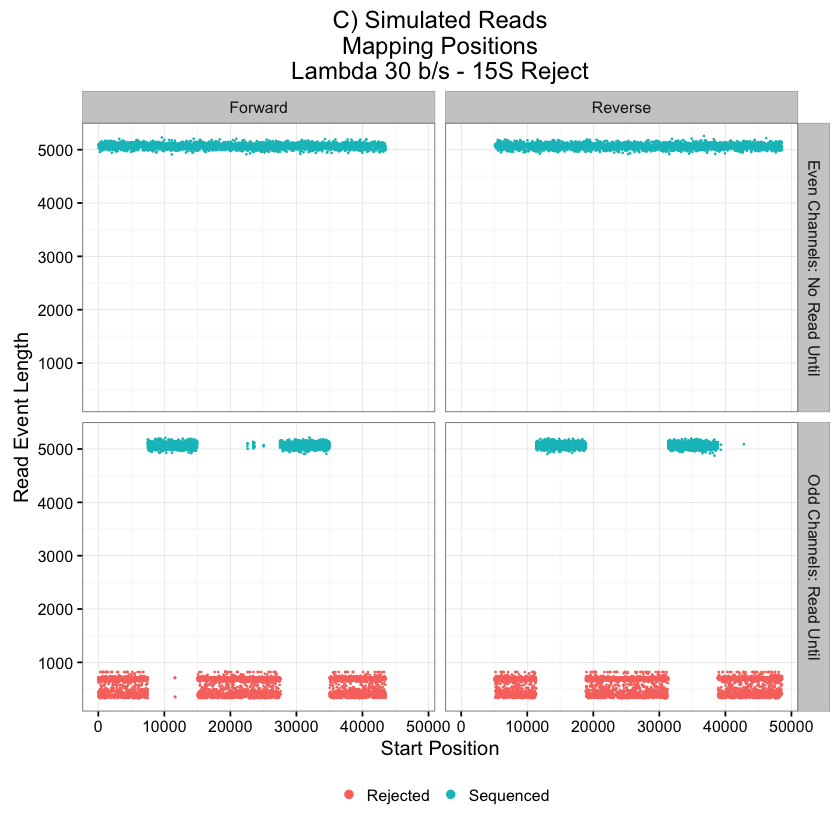

In [51]:
FigS6D=ggplot(data=subset(rawdata,read_reason!="Stopped"), aes(y=read_event_count,x=start,color=readuntil))+ facet_grid(OddEven ~ orientation) + geom_point(size = .1)+theme_bw() + theme(legend.title=element_text(), legend.position="bottom",legend.key = element_blank())+scale_color_discrete(name="") + guides(colour=guide_legend(override.aes=list(size=2)))+ labs(y="Read Event Length",x="Start Position",title = "C) Simulated Reads\nMapping Positions\nLambda 30 b/s - 15S Reject")
FigS6D

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type
1,345,J02459_R,5191,5064,TCATCAGGTTCGTGTA,2,1959,435,Unblock,Template
2,347,J02459_R,40602,4972,CATCCGGCGAAACCCG,2,1959,435,Unblock,Template
3,31,J02459_F,659,5067,AAGCCATGAACAAAGC,2,1959,463,Unblock,Template
4,33,J02459_F,43160,4952,ACGGGAAAATGCACGC,2,1959,463,Unblock,Template
5,35,J02459_R,23658,5028,GGAACTCCGGGTGCTA,2,1959,463,Unblock,Template
6,37,J02459_F,41254,5051,CTCACCGTATTGCAGG,2,1959,463,Unblock,Template


,Ref,Position,EVEN,ODD,ALL
1,simref,0,1,0,1
2,simref,1,1,0,1
3,simref,2,1,1,2
4,simref,3,1,1,2
5,simref,4,1,1,2
6,simref,5,1,1,2


[1] 56196652

[1] 28505146

[1] 27691506

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type,OddEven,readuntil,orientation,start
1,345,J02459_R,5191,5064,TCATCAGGTTCGTGTA,2,1959,435,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,43409
2,347,J02459_R,40602,4972,CATCCGGCGAAACCCG,2,1959,435,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,7998
3,31,J02459_F,659,5067,AAGCCATGAACAAAGC,2,1959,463,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,659
4,33,J02459_F,43160,4952,ACGGGAAAATGCACGC,2,1959,463,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,43160
5,35,J02459_R,23658,5028,GGAACTCCGGGTGCTA,2,1959,463,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,24942
6,37,J02459_F,41254,5051,CTCACCGTATTGCAGG,2,1959,463,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,41254


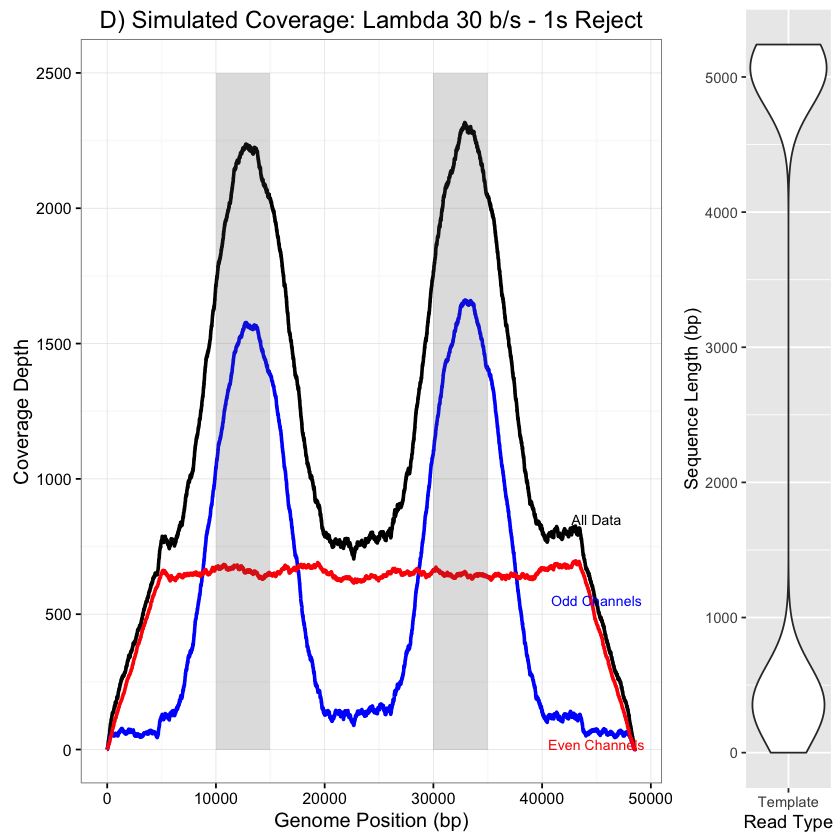

In [52]:
rawdata1 = read.csv("data/simulations/lambda_shortreads_1s_250m_5kb.log", header = TRUE, sep=",")


rawdata1$type<-"Template"
head (rawdata1)
#ggplot(data=rawdata,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")



EVEN2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_EVEN.txt", header = FALSE,sep="\t")
ODD2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_ODD.txt", header = FALSE,sep="\t")
ALL2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_ALL.txt", header = FALSE,sep="\t")


SIM_ROI21<-cbind(EVEN2_SIM_1D_ROI1,ODD2_SIM_1D_ROI1$V3,ALL2_SIM_1D_ROI1$V3)
colnames(SIM_ROI21) <- c("Ref", "Position","EVEN","ODD","ALL")
head(SIM_ROI21)

#ggplot(data=SIM_ROI2,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "D) Simulated Coverage: Lambda 30 b/s")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)



sum(SIM_ROI21$ALL)
sum(SIM_ROI21$EVEN)
sum(SIM_ROI21$ODD)



Fig2Bi<-ggplot(data=SIM_ROI21,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "D) Simulated Coverage: Lambda 30 b/s - 1s Reject")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)
Fig2Bii<-ggplot(data=rawdata1,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Bi,Fig2Bii,       ncol=2, nrow=1, widths=c(16, 4))




rawdata1$OddEven = "Odd Channels: Read Until"
rawdata1$OddEven[rawdata1$channel_name %% 2 == 0]<-"Even Channels: No Read Until"
rawdata1$readuntil[rawdata1$read_reason == "Unblock"]<-"Rejected"
rawdata1$readuntil[rawdata1$read_reason == "Natural"]<-"Sequenced"
rawdata1$orientation[rawdata1$seq_name == "J02459_R"]<-"Reverse"
rawdata1$orientation[rawdata1$seq_name == "J02459_F"]<-"Forward"
rawdata1$start[rawdata1$seq_name == "J02459_F"]<-rawdata1$seq_index[rawdata1$seq_name=="J02459_F"]
rawdata1$start[rawdata1$seq_name == "J02459_R"]<-48600-rawdata1$seq_index[rawdata1$seq_name=="J02459_R"]
head (rawdata1)

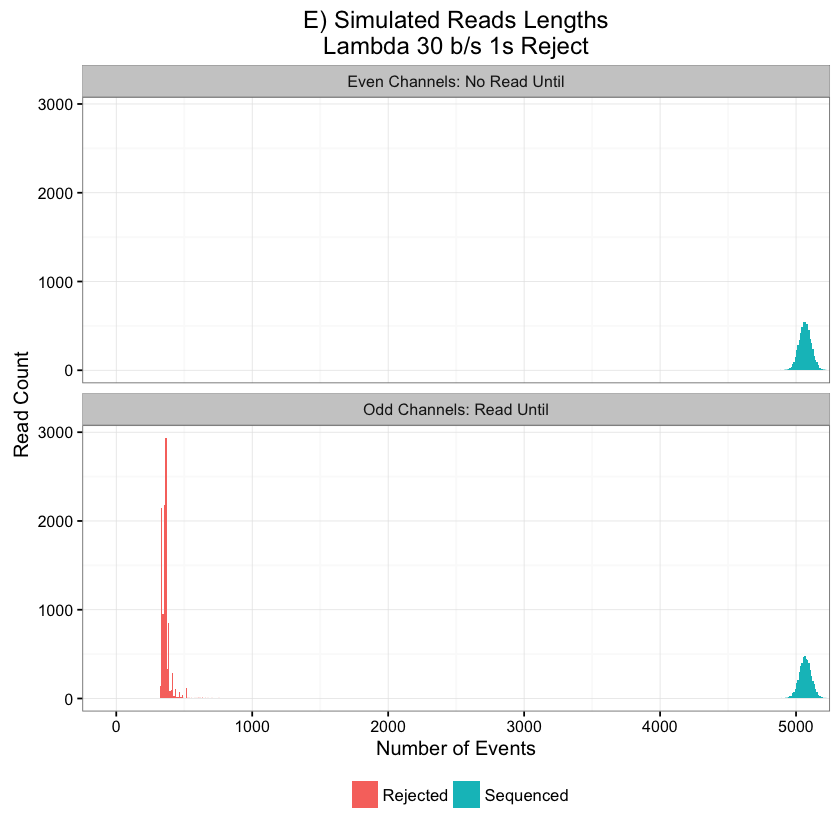

In [53]:
FigS4C=ggplot(data=subset(rawdata1,read_reason!="Stopped"),aes(x=read_event_count,fill=readuntil)) + geom_histogram(binwidth=10,position="identity",alpha = 1)+ facet_wrap(~OddEven,ncol=1) + coord_cartesian(xlim = c(0,5000))  + theme_bw()+ theme(legend.title=element_text(size=10),legend.position="bottom",legend.key = element_blank(),legend.text = element_text(size = 10, colour = "black", angle = 0)) + scale_fill_discrete(guide = guide_legend(title = NULL))+ labs(y="Read Count",x="Number of Events",title = "E) Simulated Reads Lengths\nLambda 30 b/s 1s Reject")
FigS4C

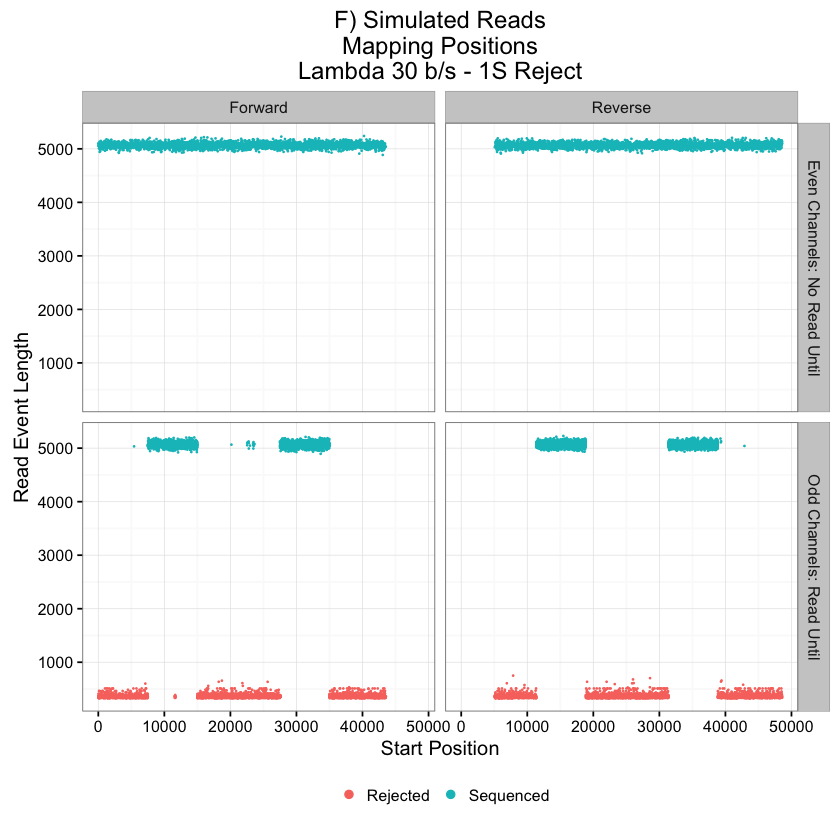

In [54]:
FigS6D=ggplot(data=subset(rawdata1,read_reason!="Stopped"), aes(y=read_event_count,x=start,color=readuntil))+ facet_grid(OddEven ~ orientation) + geom_point(size = .1)+theme_bw() + theme(legend.title=element_text(), legend.position="bottom",legend.key = element_blank())+scale_color_discrete(name="") + guides(colour=guide_legend(override.aes=list(size=2)))+ labs(y="Read Event Length",x="Start Position",title = "F) Simulated Reads\nMapping Positions\nLambda 30 b/s - 1S Reject")
FigS6D

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type
1,191,J02459_R,1051,8088,TGGCTCAGGTTGCCAT,2,2187,427,Unblock,Template
2,195,J02459_F,16185,8929,GGCAGCCAGCAGGTGA,2,2187,427,Unblock,Template
3,197,J02459_F,18038,915,GGAGGAGTTTTCGAAA,2,2187,427,Unblock,Template
4,199,J02459_R,22732,6768,CTCTCTGCTTTTTTAC,2,2187,427,Unblock,Template
5,271,J02459_F,18275,8375,CATGAACGACGTGTTC,2,2187,427,Unblock,Template
6,273,J02459_R,29700,9256,TAAGCGTGAACGTCAG,2,2187,427,Unblock,Template


,Ref,Position,EVEN,ODD,ALL
1,simref,0,6,0,6
2,simref,1,6,0,6
3,simref,2,6,0,6
4,simref,3,6,0,6
5,simref,4,6,0,6
6,simref,5,6,0,6


[1] 52043358

[1] 26140117

[1] 25903241

,channel_name,seq_name,seq_index,seq_length,seq_head,read_number,read_start,read_event_count,read_reason,type,OddEven,readuntil,orientation,start
1,191,J02459_R,1051,8088,TGGCTCAGGTTGCCAT,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,47549
2,195,J02459_F,16185,8929,GGCAGCCAGCAGGTGA,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,16185
3,197,J02459_F,18038,915,GGAGGAGTTTTCGAAA,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,18038
4,199,J02459_R,22732,6768,CTCTCTGCTTTTTTAC,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,25868
5,271,J02459_F,18275,8375,CATGAACGACGTGTTC,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Forward,18275
6,273,J02459_R,29700,9256,TAAGCGTGAACGTCAG,2,2187,427,Unblock,Template,Odd Channels: Read Until,Rejected,Reverse,18900


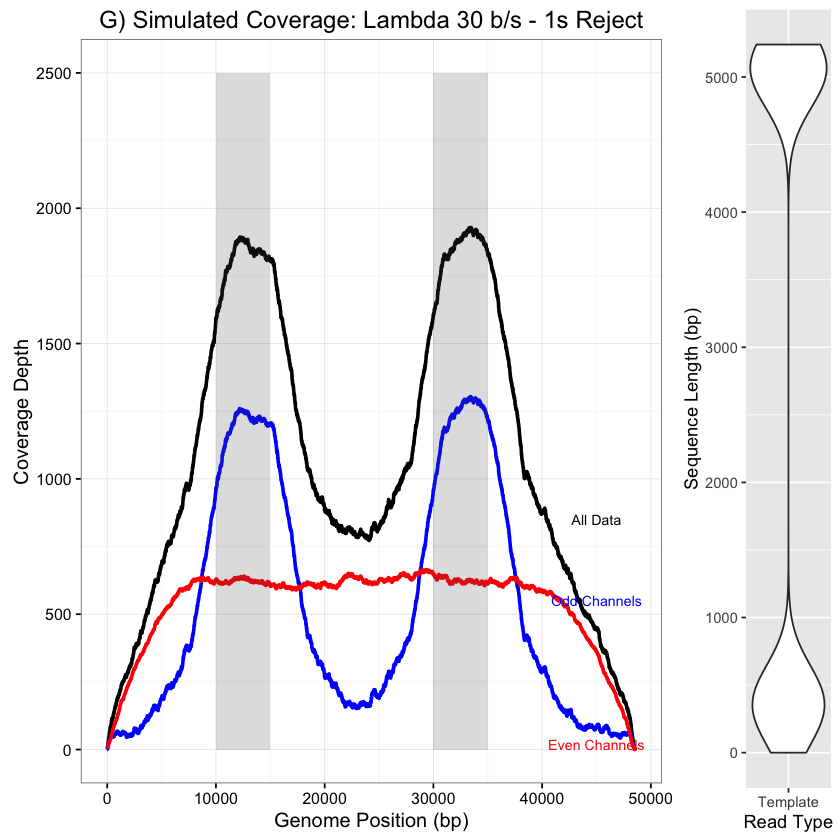

In [58]:
rawdata2 = read.csv("data/simulations/lambda_shortreads_1s_250m_5kb_bigvar.log", header = TRUE, sep=",")


rawdata2$type<-"Template"
head (rawdata2)
#ggplot(data=rawdata,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")



EVEN2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_bigvar_EVEN.txt", header = FALSE,sep="\t")
ODD2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_bigvar_ODD.txt", header = FALSE,sep="\t")
ALL2_SIM_1D_ROI1 = read.csv("data/simulations/512_2_5kb_FR_ru2_1s_250m_bigvar_ALL.txt", header = FALSE,sep="\t")


SIM_ROI21<-cbind(EVEN2_SIM_1D_ROI1,ODD2_SIM_1D_ROI1$V3,ALL2_SIM_1D_ROI1$V3)
colnames(SIM_ROI21) <- c("Ref", "Position","EVEN","ODD","ALL")
head(SIM_ROI21)

#ggplot(data=SIM_ROI2,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "D) Simulated Coverage: Lambda 30 b/s")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)



sum(SIM_ROI21$ALL)
sum(SIM_ROI21$EVEN)
sum(SIM_ROI21$ODD)



Fig2Bi<-ggplot(data=SIM_ROI21,aes(x=Position,y=ALL )) + theme_bw()+ geom_line(aes(x=Position,y=ALL),size = 1, color="black")+geom_line(aes(x=Position,y=ODD),size = 1, color="blue")+geom_line(aes(x=Position,y=EVEN),size = 1, color="red") + labs(x = "Genome Position (bp)")+labs(y="Coverage Depth",title = "G) Simulated Coverage: Lambda 30 b/s - 1s Reject")  + annotate("text", x = 45000, y = 20, label = "Even Channels", color = "red",size=3)+ annotate("text", x = 45000, y = 550, label = "Odd Channels", color = "blue",size=3) + annotate("text", x = 45000, y = 850, label = "All Data", color = "Black",size=3) + annotate("rect", xmin = 10000, xmax = 15000,ymin=0,ymax=2500,alpha = .2) + annotate("rect", xmin = 30000, xmax = 35000,ymin=0,ymax=2500,alpha = .2)
Fig2Bii<-ggplot(data=rawdata1,aes(x=type,y=read_event_count))+geom_violin()+ labs(y="Sequence Length (bp)",x="Read Type")
grid.arrange(Fig2Bi,Fig2Bii,       ncol=2, nrow=1, widths=c(16, 4))




rawdata2$OddEven = "Odd Channels: Read Until"
rawdata2$OddEven[rawdata2$channel_name %% 2 == 0]<-"Even Channels: No Read Until"
rawdata2$readuntil[rawdata2$read_reason == "Unblock"]<-"Rejected"
rawdata2$readuntil[rawdata2$read_reason == "Natural"]<-"Sequenced"
rawdata2$orientation[rawdata2$seq_name == "J02459_R"]<-"Reverse"
rawdata2$orientation[rawdata2$seq_name == "J02459_F"]<-"Forward"
rawdata2$start[rawdata2$seq_name == "J02459_F"]<-rawdata2$seq_index[rawdata2$seq_name=="J02459_F"]
rawdata2$start[rawdata2$seq_name == "J02459_R"]<-48600-rawdata2$seq_index[rawdata2$seq_name=="J02459_R"]
head (rawdata2)

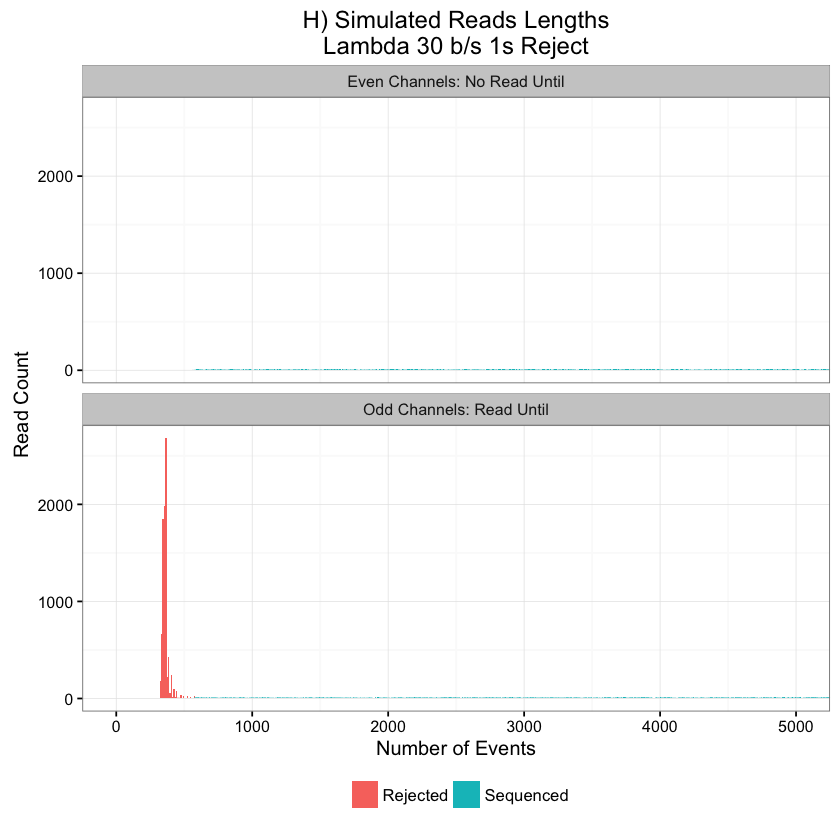

In [59]:
FigS4C=ggplot(data=subset(rawdata2,read_reason!="Stopped"),aes(x=read_event_count,fill=readuntil)) + geom_histogram(binwidth=10,position="identity",alpha = 1)+ facet_wrap(~OddEven,ncol=1) + coord_cartesian(xlim = c(0,5000))  + theme_bw()+ theme(legend.title=element_text(size=10),legend.position="bottom",legend.key = element_blank(),legend.text = element_text(size = 10, colour = "black", angle = 0)) + scale_fill_discrete(guide = guide_legend(title = NULL))+ labs(y="Read Count",x="Number of Events",title = "H) Simulated Reads Lengths\nLambda 30 b/s 1s Reject")
FigS4C

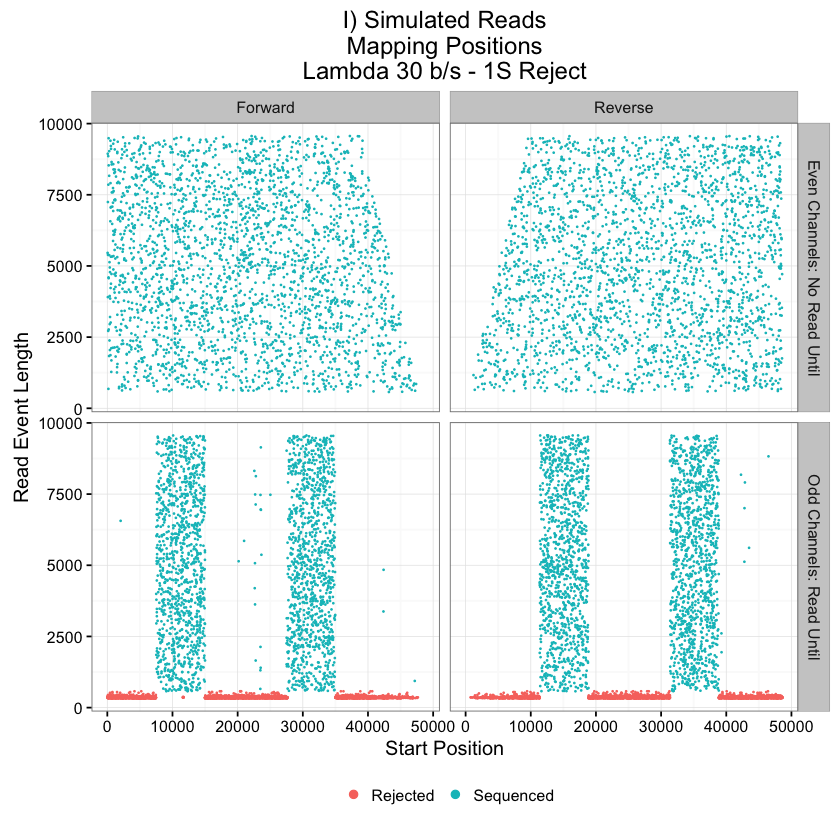

In [60]:
FigS6D=ggplot(data=subset(rawdata2,read_reason!="Stopped"), aes(y=read_event_count,x=start,color=readuntil))+ facet_grid(OddEven ~ orientation) + geom_point(size = .1)+theme_bw() + theme(legend.title=element_text(), legend.position="bottom",legend.key = element_blank())+scale_color_discrete(name="") + guides(colour=guide_legend(override.aes=list(size=2)))+ labs(y="Read Event Length",x="Start Position",title = "I) Simulated Reads\nMapping Positions\nLambda 30 b/s - 1S Reject")
FigS6D